# EDA of the Xview dataset
Dataset from [here](http://xviewdataset.org/)  This was the best benchmarking satellite machine vision dataset I could find at the time. [Paper here](https://arxiv.org/pdf/1802.07856.pdf), and a description of the dataset format [here](https://challenge.xviewdataset.org/data-format). The more recent Chinese one  [FARI1M](http://gaofen-challenge.com/) looked potentially better but was unavailable.

Only 60% of the dataset is provided.  The competition organisers held back 20% for leaderboard, and 20% for private test set and they have never been released.  I was mainly interested in the vehicle categories, but I pre-trained a YOLO model on all categories to improve generalisation.

I used the included geoExplore_environment.yml for data exploration.  Usage: `conda env create -f geoExplore_environment.yml`

In [1]:
import random
from pathlib import Path
import pandas as pd
import geopandas as gpd
import contextily as cx
import cv2
import matplotlib.pyplot as plt
import os
from os import sep
import json
import math
import seaborn as sns

Setup file paths

In [2]:
LABELS_XML_NM = 'X_view' + sep + 'train_labels' + sep + 'xView_train.geojson'
LABELS_CSV_NM = 'X_view' + sep +  'train_labels' + sep + 'xView_train_csv.csv'
CLASS_MAP_CSV_NM = 'X_view' + sep + 'xView_class_map.csv'
LABELS_FLDR = 'X_view' + sep + 'train_labels' + sep + 'xView_train.geojson'
DATA_FLDR_NM = 'Data'
IMAGE_FLDR_NM = 'X_view' + sep + 'train_images'
TRANSPORT_CLASSES = [0,1,2,3,4,5,6,7,8,9,10,24,25]  # change to suit
BUILDING_CLASSES = [46, 47, 48, 49, 50, 51]

project_directory = Path.cwd().parent
labels_json_pth = project_directory / DATA_FLDR_NM / LABELS_XML_NM
labels_csv_pth = project_directory / DATA_FLDR_NM / LABELS_CSV_NM
class_map_pth = project_directory / DATA_FLDR_NM / CLASS_MAP_CSV_NM
labels_fldr = project_directory / DATA_FLDR_NM / LABELS_FLDR
image_fldr = project_directory / DATA_FLDR_NM / IMAGE_FLDR_NM

Try taking a look at one line of the .json file

In [3]:
with open(labels_json_pth,'r') as f:
    text = f.read(2000)
text

'{"crs": {"properties": {"name": "urn:ogc:def:crs:OGC:1.3:CRS84"}, "type": "name"}, "type": "FeatureCollection", "features": [{"type": "Feature", "properties": {"bounds_imcoords": "2712,1145,2746,1177", "edited_by": "wwoscarbecerril", "cat_id": "1040010028371A00", "type_id": 73, "ingest_time": "2017/07/24 12:49:09.118+00", "index_right": 2356, "image_id": "2355.tif", "point_geom": "0101000020E6100000616E4E6406A256C03BE6ADA0D6212D40", "feature_id": 374410, "grid_file": "Grid2.shp"}, "geometry": {"type": "Polygon", "coordinates": [[[-90.53169885094464, 14.56603647302396], [-90.53169885094464, 14.56614473506768], [-90.53158140073565, 14.56614473506768], [-90.53158140073565, 14.56603647302396], [-90.53169885094464, 14.56603647302396]]]}}, {"type": "Feature", "properties": {"bounds_imcoords": "2720,2233,2760,2288", "edited_by": "wwoscarbecerril", "cat_id": "1040010028371A00", "type_id": 73, "ingest_time": "2017/07/24 17:26:05.701+00", "index_right": 2356, "image_id": "2355.tif", "point_geom

In [4]:
with open(labels_json_pth, 'r') as infile:
    data = json.load(infile)
    keys = list(data.keys())
    print(keys)

['crs', 'type', 'features', 'name']


In [5]:
data['crs']

{'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}, 'type': 'name'}

This dataset is using EPSG:4326

In [6]:
data['type']

'FeatureCollection'

In [7]:
data['name']

'U-LIMDIS_xView_Final'

So at the top level there are four elements:
'crs': storing the nested CRS information
'features': the actual labels.  This is the key of interest.
'type': a feature collection

In [8]:
feature_list = data['features']
feature_list [0:1]

[{'type': 'Feature',
  'properties': {'bounds_imcoords': '2712,1145,2746,1177',
   'edited_by': 'wwoscarbecerril',
   'cat_id': '1040010028371A00',
   'type_id': 73,
   'ingest_time': '2017/07/24 12:49:09.118+00',
   'index_right': 2356,
   'image_id': '2355.tif',
   'point_geom': '0101000020E6100000616E4E6406A256C03BE6ADA0D6212D40',
   'feature_id': 374410,
   'grid_file': 'Grid2.shp'},
  'geometry': {'type': 'Polygon',
   'coordinates': [[[-90.53169885094464, 14.56603647302396],
     [-90.53169885094464, 14.56614473506768],
     [-90.53158140073565, 14.56614473506768],
     [-90.53158140073565, 14.56603647302396],
     [-90.53169885094464, 14.56603647302396]]]}}]

In [9]:
feature_list [3009:3010]

[{'type': 'Feature',
  'properties': {'bounds_imcoords': '1451,1631,1475,1665',
   'edited_by': 'wwgabrielfernandez',
   'cat_id': '1040010028371A00',
   'type_id': 73,
   'ingest_time': '2017/07/19 18:23:31.153+00',
   'index_right': 2356,
   'image_id': '2356.tif',
   'point_geom': '0101000020E61000007B9863D1B5A156C031A9D8BA0D212D40',
   'feature_id': 273322,
   'grid_file': 'Grid2.shp'},
  'geometry': {'type': 'Polygon',
   'coordinates': [[[-90.52676412531221, 14.564615725964687],
     [-90.52676412531221, 14.564500025202351],
     [-90.52668044572764, 14.564500025202351],
     [-90.52668044572764, 14.564615725964687],
     [-90.52676412531221, 14.564615725964687]]]}}]

In [10]:
feature_list [-2:-1]

[{'type': 'Feature',
  'properties': {'bounds_imcoords': '1917,38,1958,64',
   'edited_by': 'wwoscarbecerril',
   'cat_id': '1040010029A6F400',
   'type_id': 73,
   'ingest_time': '2017/07/20 20:00:09.628+00',
   'index_right': 389,
   'image_id': '389.tif',
   'point_geom': '0101000020E61000003C99A0629CB95840CE2F5BD4444C0D40',
   'feature_id': 320500,
   'grid_file': 'Grid97.shp'},
  'geometry': {'type': 'Polygon',
   'coordinates': [[[98.90009836353885, 3.662195608931879],
     [98.90009836353885, 3.662285704836123],
     [98.90024163439081, 3.662285704836123],
     [98.90024163439081, 3.662195608931879],
     [98.90009836353885, 3.662195608931879]]]}}]

[From the challenge website](https://challenge.xviewdataset.org/data-format)
TYPE_ID	The bounding box label class ID
CAT_ID	DigitalGlobe's unique ID for image strips
IMAGE_ID	The image chip filename on which a feature is marked
BOUNDS_IMCOORDS	Bounding box in pixel coordinates [xmin, ymin, xmax, ymax] of the image chip in which it is marked
COORDINATES	Coordinates in longitude-latitude form for bounding box points

So looking at this, we need to extract 'image_id'(1), bounds_imcoords (4), type_ID  Also we need to figure out what the 'type_id' corresponds to.

Finally it would be useful to have the geolocation, but maybe just for the centre of the box.  Then we could look at where the images have come from on a world map.  This data could be saved as a csv, with 8 columns.

In [11]:
COLUMNS = ['IMAGE_ID', 'TYPE_ID', 'XMIN', 'YMIN', 'XMAX', 'YMAX', 'LONG', 'LAT']

In [12]:
data = []
for feature in feature_list:
    properties = feature['properties'] # a dict
    img_id = properties['image_id']  # '389.tif'
    type_id = properties['type_id']
    bbox = properties['bounds_imcoords'].split(",")  # eg '1917,38,1958,64'
    geometry = feature ['geometry']
    coords = geometry['coordinates'][0] #for some reason it's a list of lists
    long = coords[0][0] / 2  + coords[2][0] / 2
    lat = coords[0][1] / 2  + coords[1][1] / 2
    one_row = [img_id, type_id, bbox[0], bbox[1], bbox[2], bbox[3], long, lat]
    data.append(one_row)

instances = len(data)
instances

601937

In [13]:
df = pd.DataFrame(data, columns = COLUMNS)
df[['XMIN', 'YMIN', 'XMAX', 'YMAX']] = df[['XMIN', 'YMIN', 'XMAX', 'YMAX']].apply(pd.to_numeric)
df.head()

,IMAGE_ID,TYPE_ID,XMIN,YMIN,XMAX,YMAX,LONG,LAT
0,2355.tif,73,2712,1145,2746,1177,-90.531640,14.566091
1,2355.tif,73,2720,2233,2760,2288,-90.531603,14.562313
2,2355.tif,73,2687,1338,2740,1399,-90.531694,14.565379
3,2355.tif,73,2691,1201,2730,1268,-90.531704,14.565838
4,2355.tif,73,2671,838,2714,869,-90.531766,14.567149


In [14]:
unique_ids = df.TYPE_ID.unique().tolist()
print(sorted(unique_ids))

[11, 12, 13, 15, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 32, 33, 34, 35, 36, 37, 38, 40, 41, 42, 44, 45, 47, 49, 50, 51, 52, 53, 54, 55, 56, 57, 59, 60, 61, 62, 63, 64, 65, 66, 71, 72, 73, 74, 75, 76, 77, 79, 82, 83, 84, 86, 89, 91, 93, 94]


In [15]:
len(unique_ids)

62

There should only be 60 classes!  Figure out what is going on.  The current list from website is below:

In [16]:
old_dict = {
    11:'Fixed-wing Aircraft', 12:'Small Aircraft', 13:'Passenger/Cargo Plane', 15:'Helicopter',
    17:'Passenger Vehicle', 18:'Small Car', 19:'Bus', 20:'Pickup Truck', 21:'Utility Truck',
    23:'Truck', 24:'Cargo Truck', 25:'Truck Tractor w/ Box Trailer', 26:'Truck Tractor',27:'Trailer',
    28:'Truck Tractor w/ Flatbed Trailer', 29:'Truck Tractor w/ Liquid Tank', 32:'Crane Truck',
    33:'Railway Vehicle', 34:'Passenger Car', 35:'Cargo/Container Car', 36:'Flat Car', 37:'Tank car',
    38:'Locomotive', 40:'Maritime Vessel', 41:'Motorboat', 42:'Sailboat', 44:'Tugboat', 45:'Barge',
    47:'Fishing Vessel', 49:'Ferry', 50:'Yacht', 51:'Container Ship', 52:'Oil Tanker',
    53:'Engineering Vehicle', 54:'Tower crane', 55:'Container Crane', 56:'Reach Stacker',
    57:'Straddle Carrier', 59:'Mobile Crane', 60:'Dump Truck', 61:'Haul Truck', 62:'Scraper/Tractor',
    63:'Front loader/Bulldozer', 64:'Excavator', 65:'Cement Mixer', 66:'Ground Grader', 71:'Hut/Tent',
    72:'Shed', 73:'Building', 74:'Aircraft Hangar', 76:'Damaged Building', 77:'Facility', 79:'Construction Site',
    83:'Vehicle Lot', 84:'Helipad', 86:'Storage Tank', 89:'Shipping container lot', 91:'Shipping Container',
    93:'Pylon', 94:'Tower'}

In [17]:
print(len(old_dict))

60


There are values missing, and the classes start from 11. Looking for the extra values:

In [18]:
old_keys = sorted(list(old_dict.keys()))  #not strictly necessary, but makes the above list robust to accidental re-ordering
set(unique_ids) - set(old_keys)

{75, 82}

75 and 82 are the unknown classes.

In [19]:
mask_75, mask_82 = df['TYPE_ID'] == 75, df['TYPE_ID'] == 82
df_75, df_82 = df[mask_75], df[mask_82]
print(f'There are {len(df_75)} instances of category 75 \nThere are {len(df_82)} instances of category 8')
df_75.head()

There are 51 instances of category 75 
There are 28 instances of category 8


,IMAGE_ID,TYPE_ID,XMIN,YMIN,XMAX,YMAX,LONG,LAT
23194,2308.tif,75,2580,1142,2944,1370,28.797269,40.992532
23602,2308.tif,75,2579,176,2719,256,28.796887,40.996034
26848,2313.tif,75,658,809,782,878,28.790635,41.002928
41486,1457.tif,75,94,1568,559,1826,54.438874,24.420958
43546,1468.tif,75,2807,446,2835,474,54.466559,24.434359


In [20]:
def get_boxes(in_df, class_list=[]):
    if class_list:
        # keep only rows where TYPE_ID IS in the class list
        in_df = in_df[in_df['TYPE_ID'].isin(class_list)]

    unique_images = in_df.IMAGE_ID.unique().tolist()
    boxs = {}
    for image in unique_images:
        mask = in_df['IMAGE_ID'] == image
        masked = in_df[mask][['TYPE_ID', 'XMIN', 'YMIN', 'XMAX', 'YMAX']]
        boxs[image] = masked.values.tolist()
    return boxs

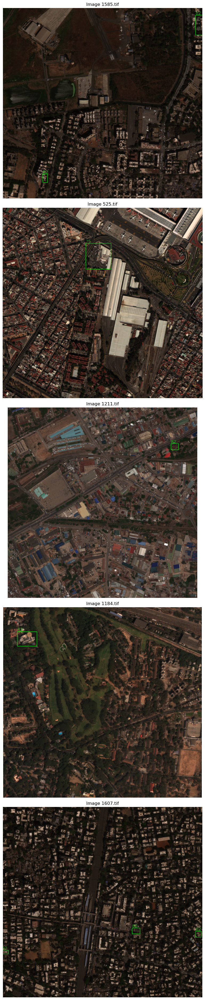

In [21]:
def display_images(image_list, boxes_dict, max_images=6, txt=False, zoom=1):
    total_ims = len(image_list)
    display_ims = min(max_images, total_ims)
    no_cols = 1
    no_rows = display_ims//no_cols + (display_ims % no_cols > 0)
    fig, axs = plt.subplots(no_rows, no_cols, figsize=(10, 10*no_rows/no_cols*3/4))
    axs = axs.flatten()
    random.shuffle(image_list)
    for k, img_nm in enumerate(image_list[:display_ims]):
        img_pth = str(image_fldr / img_nm)
        im = cv2.imread(img_pth)    # tried using the flag cv2.IMREAD_ANYDEPTH flag, because images are 24 bit, but that removed the color channels.
        im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
        init_h, init_w, _ = im.shape
        zoom_h, zoom_w, = round(init_h/zoom), round(init_w/zoom)
        im = im[0:zoom_h, 0:zoom_w]
        #im = cv2.resize(im, None, fx=zoom, fy=zoom)

        dh, dw, _ = im.shape
        # create a bounding box with the data & draw it
        if img_nm in boxes_dict:
            for box in boxes_dict[img_nm]:
                box_id, x_min, y_min, x_max, y_max = box
                x_min, y_min, x_max, y_max = int(x_min), int(y_max), int(x_max), int(y_min)
                # (left top), (right bottom) == (XMIN, YMAX), (XMAX, YMIN)   # Something is wrong here!

                # suspect the original coordinates are relative to the bottom left of the image.  I had two wrongs making a right here

                cv2.rectangle(im, (x_min, y_min), (x_max, y_max), (0,255,0), thickness=math.ceil(3/zoom))
                if txt:
                    font_size = math.ceil(2/zoom)
                    font_thickness = math.ceil(2/zoom)
                    cv2.putText(im, str(box_id), (x_min, y_max-10), cv2.FONT_HERSHEY_SIMPLEX, font_size, (36,255,12), font_thickness )

        # Show image with bboxes
        axs[k].set_title(f"Image {img_nm}", fontsize = 12)
        axs[k].imshow(im)
        axs[k].set_axis_off()

    # Display all the images
    plt.tight_layout()
    plt.show()

boxes = get_boxes(df, [75,82])
img_list = list(boxes.keys())  #could use any image list here if needed
display_images(img_list, boxes, 5, True)

The above confirms I've got the coordinate system correct and can proceed building the dataset.  Category 75 & 82 look meaningless.  I've then confirmed that both are erroneous and can be ignored.  Also I've since found there is a discussion about it [here](https://github.com/DIUx-xView/xView1_baseline/issues/3)

Removing the entries with TYPE_ID == 75 and 82

In [22]:
df = df[(df.TYPE_ID != 75) & (df.TYPE_ID != 82)]
print(f'{instances - len(df)} rows removed, leaving {len(df)} rows')

79 rows removed, leaving 601858 rows


I'm going to make a new class category mapping and save that as a csv for future reference.

In [23]:
new_dict = {old_dict[x]:y for y, x in enumerate(old_keys)}
print(new_dict)

{'Fixed-wing Aircraft': 0, 'Small Aircraft': 1, 'Passenger/Cargo Plane': 2, 'Helicopter': 3, 'Passenger Vehicle': 4, 'Small Car': 5, 'Bus': 6, 'Pickup Truck': 7, 'Utility Truck': 8, 'Truck': 9, 'Cargo Truck': 10, 'Truck Tractor w/ Box Trailer': 11, 'Truck Tractor': 12, 'Trailer': 13, 'Truck Tractor w/ Flatbed Trailer': 14, 'Truck Tractor w/ Liquid Tank': 15, 'Crane Truck': 16, 'Railway Vehicle': 17, 'Passenger Car': 18, 'Cargo/Container Car': 19, 'Flat Car': 20, 'Tank car': 21, 'Locomotive': 22, 'Maritime Vessel': 23, 'Motorboat': 24, 'Sailboat': 25, 'Tugboat': 26, 'Barge': 27, 'Fishing Vessel': 28, 'Ferry': 29, 'Yacht': 30, 'Container Ship': 31, 'Oil Tanker': 32, 'Engineering Vehicle': 33, 'Tower crane': 34, 'Container Crane': 35, 'Reach Stacker': 36, 'Straddle Carrier': 37, 'Mobile Crane': 38, 'Dump Truck': 39, 'Haul Truck': 40, 'Scraper/Tractor': 41, 'Front loader/Bulldozer': 42, 'Excavator': 43, 'Cement Mixer': 44, 'Ground Grader': 45, 'Hut/Tent': 46, 'Shed': 47, 'Building': 48, 'A

Save out the new class mapping for future reference

In [24]:
pd.DataFrame(new_dict.keys(), index = new_dict.values()).to_csv(class_map_pth, header=False)

Now change the ID's column in-place to use the new class mapping

In [25]:
#I could do this by mapping with the old dict to the new number.
def map_class(old_class):
    class_string = old_dict[old_class]
    return new_dict[class_string]

new_classes = df.apply(lambda row: map_class(row['TYPE_ID']), axis=1)
df['TYPE_ID'] = new_classes
df.head()

,IMAGE_ID,TYPE_ID,XMIN,YMIN,XMAX,YMAX,LONG,LAT
0,2355.tif,48,2712,1145,2746,1177,-90.531640,14.566091
1,2355.tif,48,2720,2233,2760,2288,-90.531603,14.562313
2,2355.tif,48,2687,1338,2740,1399,-90.531694,14.565379
3,2355.tif,48,2691,1201,2730,1268,-90.531704,14.565838
4,2355.tif,48,2671,838,2714,869,-90.531766,14.567149


Also, I'm going to check there aren't any annotations missing theor corresponding image files.

In [26]:
unique_images = df.IMAGE_ID.unique().tolist()
image_files = os.listdir(image_fldr)
missing_images = set(unique_images) - set(image_files)
missing_images

{'1395.tif'}

Image 1395 doesn't exist.  So I'm removing this from the dataframe.

In [27]:
old_length = len(df)
df = df[df.IMAGE_ID != '1395.tif']
print(f'{old_length - len(df)} rows removed, leaving {len(df)}')

131 rows removed, leaving 601727


At this point, I'm saving it out to a CSV so I don't loose the data, but will write a stand-alone notebook to clean the data and convert to YOLO format.

In [28]:
#df.to_csv(labels_csv_pth)

#Checking the output
#with open(labels_csv_pth) as file_obj:
#    head = [next(file_obj) for x in range(5)]
#print(*head)

In [29]:
#creat a df just for the 846 images, using the mean latitude and longitude of the labels
im_df = df[['IMAGE_ID', 'LAT', 'LONG']].groupby('IMAGE_ID').mean()
im_df.head()

,LAT,LONG
IMAGE_ID,,
10.tif,14.954325,-23.475953
100.tif,36.865724,10.252192
102.tif,36.876446,10.212916
1036.tif,1.318508,103.981236
1037.tif,1.317388,103.990498


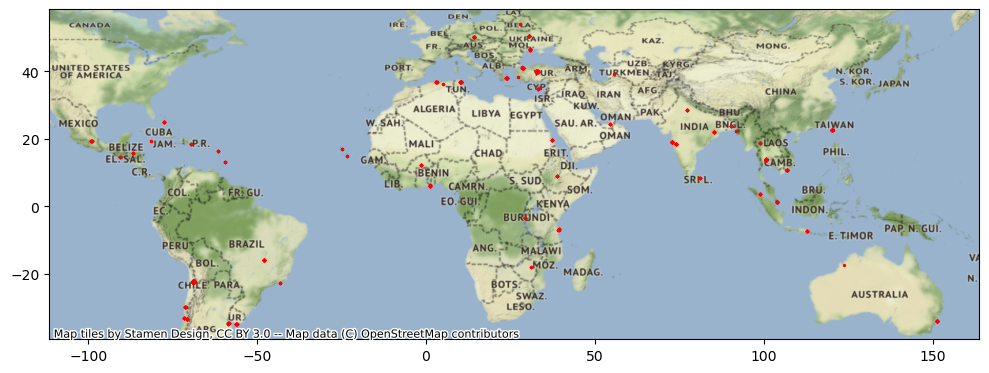

In [30]:
# Plot the geographic distribution of the labels.
images_geo_df = gpd.GeoDataFrame(im_df, geometry=gpd.points_from_xy(im_df.LONG,im_df.LAT), crs='EPSG:4326')
images_geo_df.to_crs(crs='EPSG:3857')  # change CRS for contextily
ax = images_geo_df.plot(markersize=2, color="red", figsize=(12, 6))
cx.add_basemap(ax, crs=images_geo_df.crs.to_string())
plt.show()

This dataset has excellent geographic diversity, and includes a good selection of less developed locations, which sets it apart from most of the other similar publicly available datasets.  Now I'm adding some new columns to the dataframe for further investigation

In [31]:
df['S1']= df['XMAX'] - df['XMIN']
df['S2'] = df['YMAX'] - df['YMIN']
df['AREA'] = df['S1'] * df['S2']
df['WIDTH'] = df[['S1', 'S2']].min(axis=1) * 0.3  # Approximate width in m of the labels
df['LENGTH'] = df[['S1', 'S2']].max(axis=1) * 0.3  # Approximate length in m of the labels

### A closer look at some categories of interest:
Since this project is mainly interested in vehicle detection, I'll take a closer look at the vehicle labels. I'm doing the same for buildings just out of curiosity.

In [32]:
TRANSPORT_CLASSES

vehicles = {key:value for key,value in new_dict.items() if value in TRANSPORT_CLASSES}
buildings = {key:value for key,value in new_dict.items() if value in BUILDING_CLASSES}

print(f'Vehicle categories: {vehicles}\n')
print(f'Building categories: {buildings}')

vehicles_inv = dict((val,key) for key,val in vehicles.items())
buildings_inv = dict((val,key) for key,val in buildings.items())

trans_df = df[df['TYPE_ID'].isin([key for key in vehicles.values()])]
build_df = df[df['TYPE_ID'].isin([key for key in buildings.values()])]
print('Total instances', len(trans_df))

Vehicle categories: {'Fixed-wing Aircraft': 0, 'Small Aircraft': 1, 'Passenger/Cargo Plane': 2, 'Helicopter': 3, 'Passenger Vehicle': 4, 'Small Car': 5, 'Bus': 6, 'Pickup Truck': 7, 'Utility Truck': 8, 'Truck': 9, 'Cargo Truck': 10, 'Motorboat': 24, 'Sailboat': 25}

Building categories: {'Hut/Tent': 46, 'Shed': 47, 'Building': 48, 'Aircraft Hangar': 49, 'Damaged Building': 50, 'Facility': 51}
Total instances 247812


In [33]:
trans_df.head()

,IMAGE_ID,TYPE_ID,XMIN,YMIN,XMAX,YMAX,LONG,LAT,S1,S2,AREA,WIDTH,LENGTH
40,2355.tif,5,2726,2512,2740,2518,-90.531625,14.561439,14,6,84,1.8,4.2
41,2355.tif,5,2729,2494,2737,2504,-90.531627,14.561493,8,10,80,2.4,3.0
42,2355.tif,5,2726,2501,2737,2513,-90.531631,14.561466,11,12,132,3.3,3.6
63,2355.tif,8,1858,0,1872,19,-90.534608,14.570048,14,19,266,4.2,5.7
70,2355.tif,8,1912,153,1925,162,-90.534425,14.569540,13,9,117,2.7,3.9


Plot the size distribution of the labels by category

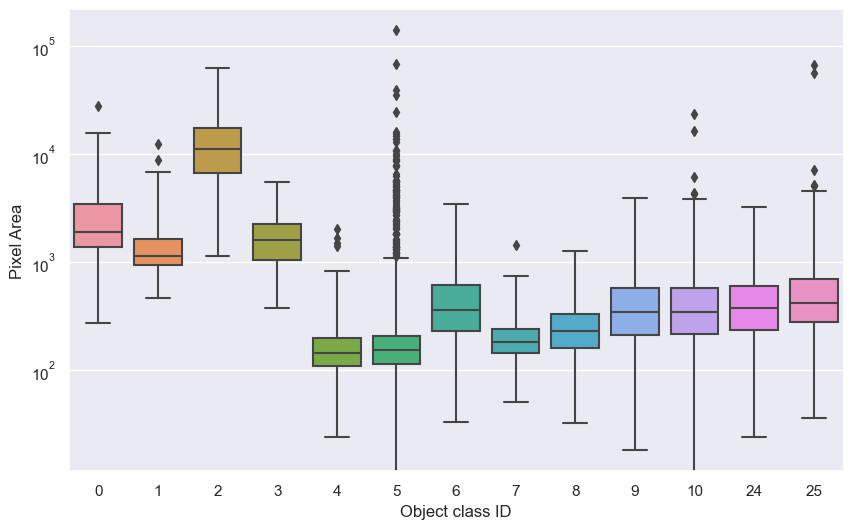

In [34]:
data = trans_df.dropna(subset=['TYPE_ID','AREA'])
sns.set(rc={'figure.figsize':(10,6)})
sns.boxplot(x='TYPE_ID', y='AREA', data=data, whis=10)
plt.xlabel('Object class ID')
plt.ylabel('Pixel Area')
plt.yscale('log')
plt.show()
#print(trans_df.area.mean())

Class 5 "Small car" has a suspiciously large variation in pixel areas.  In fact most of the classes vary by more than is reasonable for road vehicles.  This could be investigated further, likely some boxes are excessively generous around their respective objects.  Looking at this with plots for the maximum and minimum box sides, in metres might be interesting too:

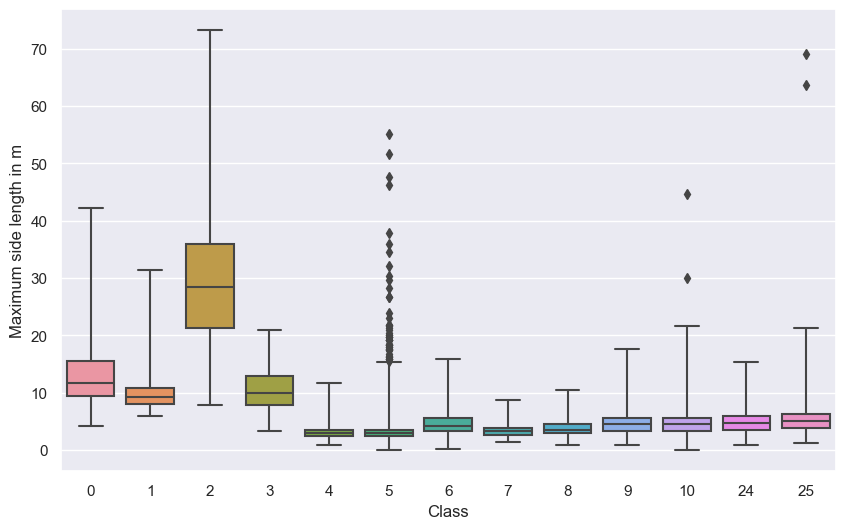

In [35]:
data = trans_df.dropna(subset=['WIDTH','TYPE_ID'])
#sns.violinplot(x='TYPE_ID', y='WIDTH', data=data, inner=None)
sns.boxplot(x='TYPE_ID', y='WIDTH', data=data, whis=10)
plt.xlabel('Class')
plt.ylabel('Maximum side length in m')
plt.show()

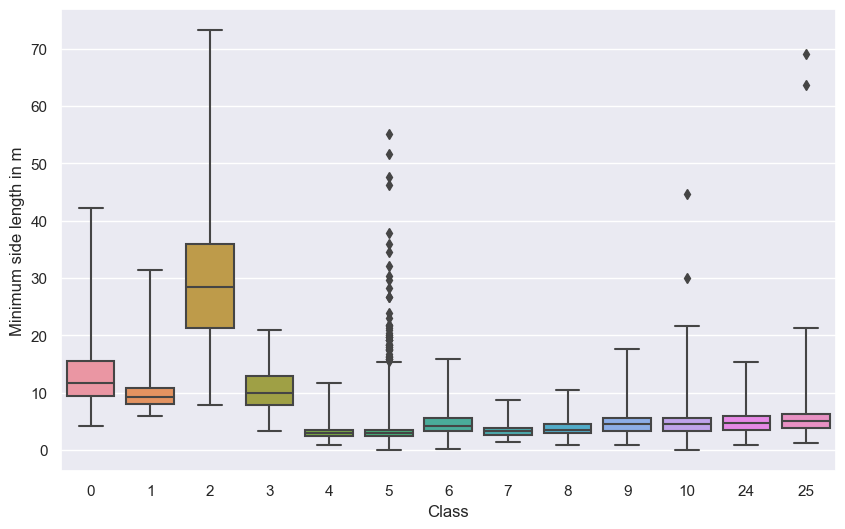

In [36]:
data = trans_df.dropna(subset=['LENGTH','TYPE_ID'])
#sns.violinplot(x='TYPE_ID', y='LENGTH', data=data, inner=None)
sns.boxplot(x='TYPE_ID', y='WIDTH', data=data, whis=10)
plt.xlabel('Class')
plt.ylabel('Minimum side length in m')
plt.show()

Some of this variation looks reasonable.  For example there is quite a wide variety for the length of a cargo plane, from 10m to 75m.  However some are clearly ridiculous, such as small cars more than 20m long. This is also by far the larges class, with 211,660 instances, so it is not surprising that it contains more outliers than other classes.  Looking even more specifically at the stats for the "small car" class 5 below:

In [37]:
trans_df[trans_df['TYPE_ID']==5].WIDTH.describe()

count    211660.000000
mean          3.096786
std           0.952145
min           0.000000
25%           2.400000
50%           3.000000
75%           3.600000
max          55.200000
Name: WIDTH, dtype: float64

In [38]:
trans_df[trans_df['TYPE_ID']==5].LENGTH.describe()

count    211660.000000
mean          4.679616
std           1.298346
min           0.000000
25%           3.900000
50%           4.500000
75%           5.400000
max         226.800000
Name: LENGTH, dtype: float64

So either there are small cars 226m long, or the labels have some errors.

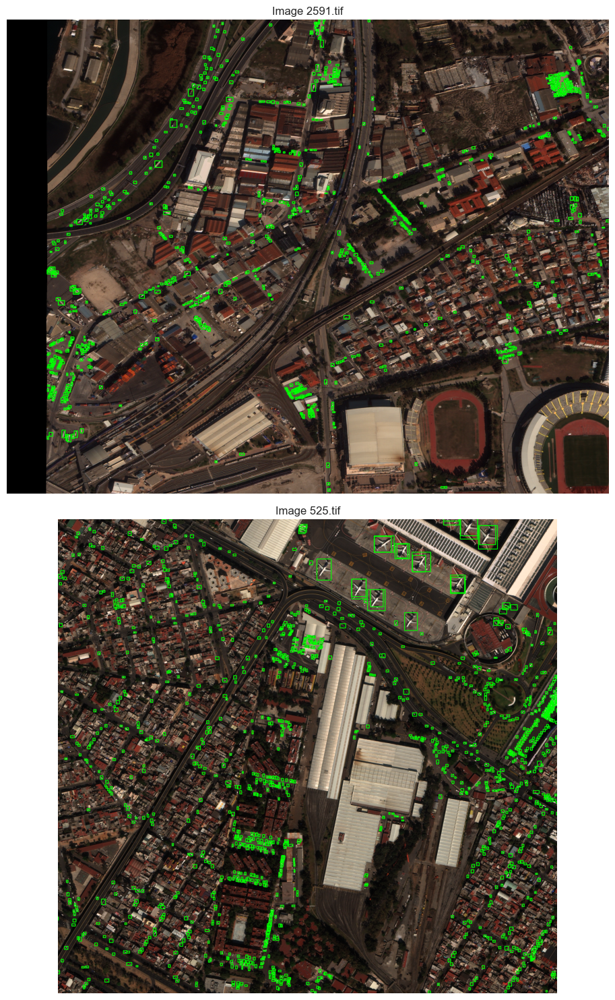

In [39]:
boxes = get_boxes(trans_df, TRANSPORT_CLASSES)
img_list = list(boxes.keys())  #could use any image list here if needed
display_images(img_list, boxes, 2, False)

The full images are too large to make out individual cars.  So re-plotting zoomed in to the top left, this will mean some images contain no labels, as I have not made any effort to zoom in on area specifically containing labels:

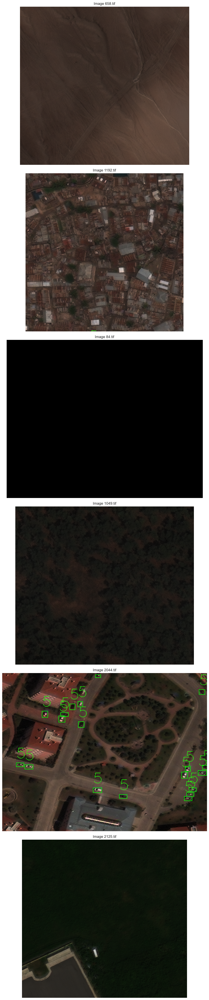

In [40]:
boxes = get_boxes(df, TRANSPORT_CLASSES)
img_list = list(boxes.keys())  #could use any image list here if needed
display_images(img_list, boxes, 6, True, 8)

Re-running the above cell a few times (with the images randomly changing), it is clear that there are a lot of false negatives in this dataset.  Many cars are not clearly present but not labeled.

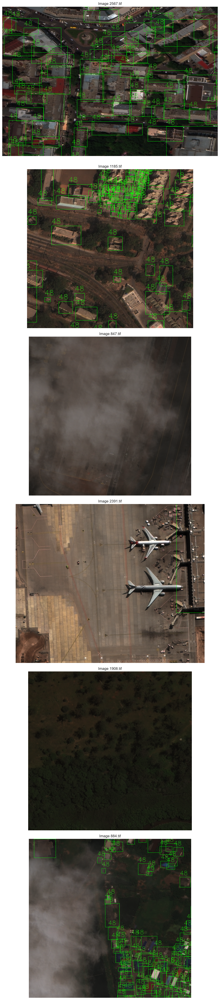

In [41]:
# Doing the same for buildings
boxes = get_boxes(build_df, BUILDING_CLASSES)
img_list = list(boxes.keys())  #could use any image list here if needed
display_images(img_list, boxes, 6, True, 4)

As with the cars, there seem to be cases missed with buildings, typically on the edge of the image.  Cropping the images by their edge may help a little to remove false negatives..

That's all I've got time for for now.   The dataset has definitely got room for further improvement, either by editing some of the erroneous labels, selective cropping, cropping the edges, dropping some of the images, or at possibly filtering or editing some the labels based on some size conditions.